# downloading data

## download data for 2024
no need to re-download - go to next section

In [30]:
# prompt: hit an api and parse the json maybe using jsonpath

import requests
# from jsonpath_ng import jsonpath, parse
# import jsonpath

# Define the API endpoint URL

# identifier:
# {"lang":"eng","limit":500,"offset":0,"orderByKey":["bookSongPosition"],"bookQueryList":["disciple-of-christ-2024-youth-album"]}
url = "https://www.churchofjesuschrist.org/media/music/api?type=songsFilteredList&lang=eng&identifier=%7B%22lang%22%3A%22eng%22%2C%22limit%22%3A500%2C%22offset%22%3A0%2C%22orderByKey%22%3A%5B%22bookSongPosition%22%5D%2C%22bookQueryList%22%3A%5B%22disciple-of-christ-2024-youth-album%22%5D%7D&batchSize=20"

# Send a GET request to the API endpoint
response = requests.get(url)

# Check if the request was successful
if response.status_code != 200:
  raise Exception('not 200')

# Parse the JSON response
json_data = response.json()

# print(json_data['data'])
# print(len(json_data['data']))
songs_2024 = [{"slug": a['slug'], "title": a['title']} for a in json_data['data']]
for s in songs_2024:
  s['info_url'] = 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=' + s['slug']
  response = requests.get(s['info_url'])
  if response.status_code != 200:
    raise Exception('not 200')
  json_data = response.json()
  assets = [a for a in json_data['data'][0]['assets'] if a['assetType'] == 'AUDIO_VOCAL']
  s['mp3_url'] = assets[0]['mediaObject']['distributionUrl']
  print(s)
print(songs_2024)



[{'title': 'Disciple of Christ', 'slug': 'disciple-of-christ-2024', 'songNumber': '1', 'arrangers': [{'preferredName': 'Mike McClellan'}], 'artists': [{'preferredName': 'Benjamin Josiah'}], 'authors': [{'preferredName': 'Nik Day'}], 'composers': [{'preferredName': 'Nik Day'}], 'instrumentations': [{'name': 'Voice'}, {'name': 'Piano'}], 'musicalFeatures': [], 'recordingAvailable': True, 'sheetMusicAvailable': True, 'tags': ['discipleship', 'Jesus Christ', 'youth'], 'voicings': [{'name': 'Unison'}], 'assets': [{'annotatedFields': {}, 'assetType': 'AUDIO_ACCOMPANIMENT', 'attributes': {}, 'locatorIds': [], 'mediaObject': {'annotatedFields': {}, 'arranger': [], 'assetID': 'a8cc66352b0611ee8d92eeeeac1e192a6e6400f2', 'attributes': {}, 'composer': [], 'description': 'Instrumental track of "Disciple of Christ" from the 2024 Youth Album.', 'distributionUrl': 'https://assets.churchofjesuschrist.org/a8/cc/a8cc66352b0611ee8d92eeeeac1e192a6e6400f2/disciple_of_christ_instrumental_2024.mp3', 'duration

IndexError: list index out of range

In [33]:
album_slugs = {
    '2024': 'disciple-of-christ-2024-youth-album',
    '2023': 'i-can-do-all-things-2023-youth-album',
    '2022': 'trust-in-the-lord-2022-youth-album',
    '2021': 'a-great-work-2021-youth-album',
    '2020': 'i-will-go-and-do-2020-youth-album',
    '2019': 'if-we-love-him-2019-youth-album',
    '2018': 'peace-in-christ-2018-youth-album',
    '2017': 'ask-of-god-2017-youth-album',
    '2016': 'press-forward-2016-youth-album',
    '2015': 'embark-2015-youth-album',
    '2014': 'come-unto-christ-2014-youth-album',
    '2013': 'stand-2013-youth-album',
}
album_slugs

{'2024': 'disciple-of-christ-2024-youth-album',
 '2023': 'i-can-do-all-things-2023-youth-album',
 '2022': 'trust-in-the-lord-2022-youth-album',
 '2021': 'a-great-work-2021-youth-album',
 '2020': 'i-will-go-and-do-2020-youth-album',
 '2019': 'if-we-love-him-2019-youth-album',
 '2018': 'peace-in-christ-2018-youth-album',
 '2017': 'ask-of-god-2017-youth-album',
 '2016': 'press-forward-2016-youth-album',
 '2015': 'embark-2015-youth-album',
 '2014': 'come-unto-christ-2014-youth-album',
 '2013': 'stand-2013-youth-album'}

## function to download album data

In [36]:
def get_album_raw_data_as_json(slug):
    import requests
    # {"lang":"eng","limit":500,"offset":0,"orderByKey":["bookSongPosition"],"bookQueryList":["disciple-of-christ-2024-youth-album"]}
    url = f"https://www.churchofjesuschrist.org/media/music/api?type=songsFilteredList&lang=eng&identifier=%7B%22lang%22%3A%22eng%22%2C%22limit%22%3A500%2C%22offset%22%3A0%2C%22orderByKey%22%3A%5B%22bookSongPosition%22%5D%2C%22bookQueryList%22%3A%5B%22{slug}%22%5D%7D&batchSize=30"

    # Send a GET request to the API endpoint
    response = requests.get(url)

    # Check if the request was successful
    if response.status_code != 200:
        raise Exception('not 200')

    # Parse the JSON response
    json_data = response.json()
    return json_data

# get_album_raw_data_as_json(album_slugs['2013'])

## download metadata for all years (do once)

In [43]:
album_data = {}
for year, slug in album_slugs.items():
    print(year, slug)
    year_data = {
        'year': year,
        'slug': slug,
        'raw_data': get_album_raw_data_as_json(slug)
    }
    album_data[year] = year_data
    print(f"{year} done")

album_data


2024 disciple-of-christ-2024-youth-album
2024 done
2023 i-can-do-all-things-2023-youth-album
2023 done
2022 trust-in-the-lord-2022-youth-album
2022 done
2021 a-great-work-2021-youth-album
2021 done
2020 i-will-go-and-do-2020-youth-album
2020 done
2019 if-we-love-him-2019-youth-album
2019 done
2018 peace-in-christ-2018-youth-album
2018 done
2017 ask-of-god-2017-youth-album
2017 done
2016 press-forward-2016-youth-album
2016 done
2015 embark-2015-youth-album
2015 done
2014 come-unto-christ-2014-youth-album
2014 done
2013 stand-2013-youth-album
2013 done


{'2024': {'year': '2024',
  'slug': 'disciple-of-christ-2024-youth-album',
  'raw_data': {'data': [{'title': 'Disciple of Christ',
     'slug': 'disciple-of-christ-2024',
     'songNumber': '1',
     'arrangers': [{'preferredName': 'Mike McClellan'}],
     'artists': [{'preferredName': 'Benjamin Josiah'}],
     'authors': [{'preferredName': 'Nik Day'}],
     'composers': [{'preferredName': 'Nik Day'}],
     'instrumentations': [{'name': 'Voice'}, {'name': 'Piano'}],
     'musicalFeatures': [],
     'recordingAvailable': True,
     'sheetMusicAvailable': True,
     'tags': ['discipleship', 'Jesus Christ', 'youth'],
     'voicings': [{'name': 'Unison'}],
     'assets': [{'annotatedFields': {},
       'assetType': 'AUDIO_ACCOMPANIMENT',
       'attributes': {},
       'locatorIds': [],
       'mediaObject': {'annotatedFields': {},
        'arranger': [],
        'assetID': 'a8cc66352b0611ee8d92eeeeac1e192a6e6400f2',
        'attributes': {},
        'composer': [],
        'description': 

## download data for song slug

In [56]:
def find_mp3_url_from_song_data(json_data):
    assets = [a for a in json_data['data'][0]['assets'] if a['assetType'] == 'AUDIO_VOCAL']
    # print(assets)
    mp3_url = assets[0]['mediaObject']['distributionUrl']
    return mp3_url

def get_song_data(slug):
  info_url = 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=' + slug
  response = requests.get(info_url)
  if response.status_code != 200:
    raise Exception('not 200')
  json_data = response.json()
  # print(json_data)
  return info_url, find_mp3_url_from_song_data(json_data), json_data

info_url, mp3_url, raw_song_data = get_song_data('disciple-of-christ-2024')
# print(mp3_url)
assert mp3_url == 'https://assets.churchofjesuschrist.org/06/dc/06dc86c82bfd11ee86d1eeeeac1e74ed918cdfbc/disciple_of_christ_2024.mp3'

In [57]:
album_data.keys()

dict_keys(['2024', '2023', '2022', '2021', '2020', '2019', '2018', '2017', '2016', '2015', '2014', '2013'])

## simplified album data

In [72]:
album_simple = {
    year: {
        'year': year, 
        'slug': data['slug'], 
    } for year, data in album_data.items()
}

# album_simple = {}
# for year, data in album_data.items():
    # album_simple['year'] = year
    # album_simple['slug'] = data['slug']
    # album_simple[year]['songs'] = 

print(len(album_data['2024']['raw_data']['data']))
album_data['2024']['raw_data']['data'][0]['slug']

# album_simple

# songs_2024 = [{"slug": a['slug'], "title": a['title']} for a in data['data']]


22


'disciple-of-christ-2024'

In [ ]:
def find_mp3_url_from_song_data(json_data):
    assets = [a for a in json_data['data'][0]['assets'] if a['assetType'] == 'AUDIO_VOCAL']
    # print(assets)
    mp3_url = assets[0]['mediaObject']['distributionUrl']
    return mp3_url

def get_song_data(slug):
  info_url = 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=' + slug
  response = requests.get(info_url)
  if response.status_code != 200:
    raise Exception('not 200')
  json_data = response.json()
  # print(json_data)
  return info_url, find_mp3_url_from_song_data(json_data), json_data

info_url, mp3_url, raw_song_data = get_song_data('disciple-of-christ-2024')
# print(mp3_url)
assert mp3_url == 'https://assets.churchofjesuschrist.org/06/dc/06dc86c82bfd11ee86d1eeeeac1e74ed918cdfbc/disciple_of_christ_2024.mp3'

## get mp3 url for all songs for all years

In [58]:
for 

{'2024': {'year': '2024',
  'slug': 'disciple-of-christ-2024-youth-album',
  'raw_data': {'data': [{'title': 'Disciple of Christ',
     'slug': 'disciple-of-christ-2024',
     'songNumber': '1',
     'arrangers': [{'preferredName': 'Mike McClellan'}],
     'artists': [{'preferredName': 'Benjamin Josiah'}],
     'authors': [{'preferredName': 'Nik Day'}],
     'composers': [{'preferredName': 'Nik Day'}],
     'instrumentations': [{'name': 'Voice'}, {'name': 'Piano'}],
     'musicalFeatures': [],
     'recordingAvailable': True,
     'sheetMusicAvailable': True,
     'tags': ['discipleship', 'Jesus Christ', 'youth'],
     'voicings': [{'name': 'Unison'}],
     'assets': [{'annotatedFields': {},
       'assetType': 'AUDIO_ACCOMPANIMENT',
       'attributes': {},
       'locatorIds': [],
       'mediaObject': {'annotatedFields': {},
        'arranger': [],
        'assetID': 'a8cc66352b0611ee8d92eeeeac1e192a6e6400f2',
        'attributes': {},
        'composer': [],
        'description': 

## hardcoded data for 2024

In [2]:
songs_2024 = [{'slug': 'disciple-of-christ-2024', 'name': 'Disciple of Christ', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=disciple-of-christ-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/06/dc/06dc86c82bfd11ee86d1eeeeac1e74ed918cdfbc/disciple_of_christ_2024.mp3'}, {'slug': 'diamond-2024', 'name': 'Diamond', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=diamond-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/92/7c/927c6c962b0611eeaaf6eeeeac1e962806a504b1/diamond_2024.mp3'}, {'slug': 'when-i-found-you-2024', 'name': 'When I Found You', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=when-i-found-you-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/04/9f/049f7ab62b0711ee8738eeeeac1eb37a3d9541ca/when_i_found_you_2024.mp3'}, {'slug': 'truth-2024', 'name': 'Truth', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=truth-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/f4/d1/f4d100492b0611eea042eeeeac1e2a2891abb4db/truth_2024.mp3'}, {'slug': 'he-still-chose-me-2024', 'name': 'He Still Chose Me', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=he-still-chose-me-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/c0/8a/c08abce82b0611eea042eeeeac1e2a2873f71f91/he_still_chose_me_2024.mp3'}, {'slug': 'one-true-hope-2024', 'name': 'One True Hope', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=one-true-hope-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/d4/a4/d4a44e862b0611eea7efeeeeac1e74eddcdf1529/one_true_hope_2024.mp3'}, {'slug': 'disciple-of-christ-piano-version-2024', 'name': 'Disciple of Christ', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=disciple-of-christ-piano-version-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/9f/97/9f97ade52b0611ee8738eeeeac1eb37ad6ae135e/disciple_of_christ_female_2024.mp3'}, {'slug': 'eternal-2024', 'name': 'Eternal', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=eternal-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/b7/8e/b78eeee62b0611ee8d92eeeeac1e192ae7f39c71/eternal_2024.mp3'}, {'slug': 'beloved-2024', 'name': 'Beloved', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=beloved-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/7c/73/7c738e142b0611eea5edeeeeac1e2eaaf6b8a2ae/beloved_2024.mp3'}, {'slug': 'over-mine-2024', 'name': 'Over Mine', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=over-mine-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/df/d4/dfd43a962b0611eea4e8eeeeac1eecd59fa4270b/over_mine_2024.mp3'}, {'slug': 'savior-of-my-soul-2024', 'name': 'Savior of My Soul', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=savior-of-my-soul-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/ea/11/ea113b282b0611eeb868eeeeac1e0bba4f0489de/savior_of_my_soul_2024.mp3'}, {'slug': 'living-water-2024', 'name': 'Living Water', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=living-water-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/c9/e8/c9e881072b0611eebf15eeeeac1e1d3cca142b72/living_water_2023.mp3'}, {'slug': 'beloved-reimagined-2024', 'name': 'Beloved', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=beloved-reimagined-2024', 'mp3_url': 'https://assets.churchofjesuschrist.org/88/1a/881a7ee92b0611eea81ceeeeac1e2639169d068d/beloved_reimagined.mp3'}, {'slug': 'its-not-hopeless', 'name': 'It’s Not Hopeless', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=its-not-hopeless', 'mp3_url': 'https://assets.churchofjesuschrist.org/9b/bd/9bbd6af2b6c811edb281eeeeac1eb48cb460bc77/its_not_hopeless.mp3'}, {'slug': 'free-2023', 'name': 'Free', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=free-2023', 'mp3_url': 'https://assets.churchofjesuschrist.org/d9/6f/d96f6367c43511edb0d7eeeeac1ee259a798b05a/free_2023.mp3'}, {'slug': 'no-stranger', 'name': 'No Stranger', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=no-stranger', 'mp3_url': 'https://assets.churchofjesuschrist.org/fb/49/fb490144e92911edb0a5eeeeac1ea07d6f067e59/no_stranger_2023.mp3'}, {'slug': 'i-choose-you-emolyn', 'name': 'I Choose You', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=i-choose-you-emolyn', 'mp3_url': 'https://assets.churchofjesuschrist.org/8f/82/8f8260990c7411ee9bbbeeeeac1ece4f80885f76/i_choose_you_sadie_2023.mp3'}, {'slug': 'next-to-me', 'name': 'Next to Me', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=next-to-me', 'mp3_url': 'https://assets.churchofjesuschrist.org/80/8c/808c9e6e121011eea61deeeeac1e49d649c960bb/next_to_me_2023.mp3'}, {'slug': 'if-you-believe-ellie-2023', 'name': 'If You Believe (feat. Ellie Barry)', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=if-you-believe-ellie-2023', 'mp3_url': 'https://assets.churchofjesuschrist.org/51/08/5108034e203111ee9b61eeeeac1e2238b403fb54/if_you_believe_ellie_2023.mp3'}, {'slug': 'together', 'name': 'Together', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=together', 'mp3_url': 'https://assets.churchofjesuschrist.org/2d/df/2ddfd88821a111ee9be7eeeeac1e65aa8c35a423/together_2023.mp3'}, {'slug': 'celebrate', 'name': 'Celebrate', 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=celebrate', 'mp3_url': 'https://assets.churchofjesuschrist.org/27/f9/27f939c621a111ee9b06eeeeac1ea18de853183a/celebrate_2023.mp3'}]
songs = {s['slug']: s for s in songs_2024}
songs

{'disciple-of-christ-2024': {'slug': 'disciple-of-christ-2024',
  'name': 'Disciple of Christ',
  'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=disciple-of-christ-2024',
  'mp3_url': 'https://assets.churchofjesuschrist.org/06/dc/06dc86c82bfd11ee86d1eeeeac1e74ed918cdfbc/disciple_of_christ_2024.mp3'},
 'diamond-2024': {'slug': 'diamond-2024',
  'name': 'Diamond',
  'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=diamond-2024',
  'mp3_url': 'https://assets.churchofjesuschrist.org/92/7c/927c6c962b0611eeaaf6eeeeac1e962806a504b1/diamond_2024.mp3'},
 'when-i-found-you-2024': {'slug': 'when-i-found-you-2024',
  'name': 'When I Found You',
  'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=when-i-found-you-2024',
  'mp3_url': 'https://assets.churchofjesuschrist.org/04/9f/049f7ab62b0711ee8738eeeeac1eb37a3d9541ca/when_i_found_you_2024.mp3'},
 'truth-2024': 

## inspect a single song

In [3]:
song = songs_2024[0]
song

{'slug': 'disciple-of-christ-2024',
 'name': 'Disciple of Christ',
 'info_url': 'https://www.churchofjesuschrist.org/media/music/api?type=song&lang=eng&identifier=disciple-of-christ-2024',
 'mp3_url': 'https://assets.churchofjesuschrist.org/06/dc/06dc86c82bfd11ee86d1eeeeac1e74ed918cdfbc/disciple_of_christ_2024.mp3'}

## function to download a single song

In [4]:
# prompt: download an mp3 file

import requests

def download_song(song):

  print('downloading song', song['slug'])

  # Get the MP3 URL from the song dictionary
  mp3_url = song['mp3_url']

  # Download the MP3 file
  response = requests.get(mp3_url)

  # Save the MP3 file to the local filesystem
  with open(song['slug'] + '.mp3', 'wb') as f:
    f.write(response.content)


## download a single song

In [5]:
download_song(songs_2024[0])

downloading song disciple-of-christ-2024


## download all 2024 songs

In [6]:
# prompt: download each song

for song in songs_2024:
  download_song(song)


downloading song disciple-of-christ-2024


downloading song diamond-2024
downloading song when-i-found-you-2024
downloading song truth-2024
downloading song he-still-chose-me-2024
downloading song one-true-hope-2024
downloading song disciple-of-christ-piano-version-2024
downloading song eternal-2024
downloading song beloved-2024
downloading song over-mine-2024
downloading song savior-of-my-soul-2024
downloading song living-water-2024
downloading song beloved-reimagined-2024
downloading song its-not-hopeless
downloading song free-2023
downloading song no-stranger
downloading song i-choose-you-emolyn
downloading song next-to-me
downloading song if-you-believe-ellie-2023
downloading song together
downloading song celebrate


## play a song

In [7]:
# prompt: play one of the songs

from IPython.display import Audio
# Audio('disciple-of-christ-20')
Audio('beloved-2024.mp3')
# Audio('beloved-reimagined-2024.mp3')


In [8]:
Audio('beloved-reimagined-2024.mp3')


# classifying a song

## load a song

In [10]:
!which pip3

/Users/jtoronto/anaconda3/bin/pip3


In [11]:
!pip3 install librosa

  Obtaining dependency information for librosa from https://files.pythonhosted.org/packages/e2/a2/4f639c1168d7aada749a896afb4892a831e2041bebdcf636aebfe9e86556/librosa-0.10.1-py3-none-any.whl.metadata
  Obtaining dependency information for audioread>=2.1.9 from https://files.pythonhosted.org/packages/57/8d/30aa32745af16af0a9a650115fbe81bde7c610ed5c21b381fca0196f3a7f/audioread-3.0.1-py3-none-any.whl.metadata
  Obtaining dependency information for soundfile>=0.12.1 from https://files.pythonhosted.org/packages/c8/73/059c84343be6509b480013bf1eeb11b96c5f9eb48deff8f83638011f6b2c/soundfile-0.12.1-py2.py3-none-macosx_10_9_x86_64.whl.metadata
  Obtaining dependency information for soxr>=0.3.2 from https://files.pythonhosted.org/packages/1c/5a/61572e3d1f5dd4c9c0a32d9f7f57b7b6089222227c881fe0945cf955261f/soxr-0.3.7-cp311-cp311-macosx_10_9_x86_64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.7/253.7 kB 3.8 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 

In [12]:
# prompt: generate spectrogram of a song or segment of a song

import numpy as np
import librosa
import matplotlib.pyplot as plt

song = songs_2024[0]

# Load the audio file
audio_file = song['slug'] + '.mp3'
print(audio_file)

# Load the audio as a time series and its sample rate
audio, sr = librosa.load(audio_file)



disciple-of-christ-2024.mp3


## mel spectrogram of song

4003928 22050 3969000
[0.09236278 0.08690727 0.0815956  0.07665203 0.07216035 0.06782788
 0.0640001  0.05981937 0.05509404 0.05076472]
(128, 7821)
128


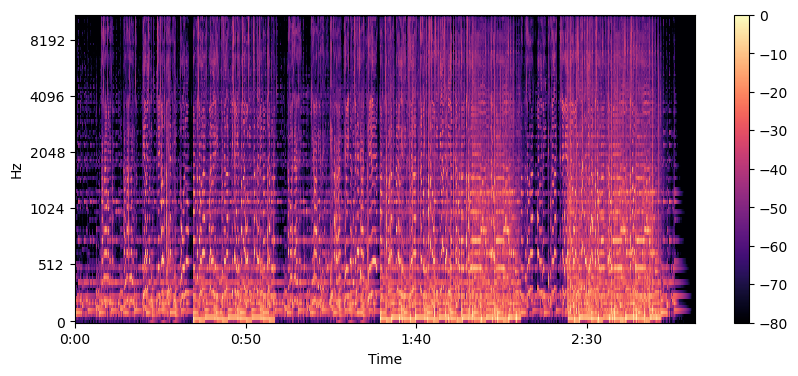

In [13]:

# Compute the spectrogram of the audio
spectrogram = librosa.feature.melspectrogram(y=audio, sr=sr)
print(len(audio), sr, sr * 3 * 60)
print(audio[10000:10010])
print(spectrogram.shape)

# Convert the spectrogram to decibels
spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)
print(len(spectrogram_db))

# Plot the spectrogram
plt.figure(figsize=(10, 4))
librosa.display.specshow(spectrogram_db, x_axis='time', y_axis='mel', sr=sr)
plt.colorbar()
plt.show()

## function to extract an audio segment

In [14]:
# prompt: extract a 10s segment of the audio starting at 50s

def extract_segment(audio, sr, start_time=50, end_time=51):
  print('extracting segment: ', 'sampling rate', sr, 'start_time', start_time, 'end_time', end_time)
  audio_segment = audio[int(start_time * sr):int(end_time * sr)]
  return audio_segment

audio_segment = extract_segment(audio, sr, 50, 51)

extracting segment:  sampling rate 22050 start_time 50 end_time 51


## function to display a spectrogram of an audio

(128, 44)
(128, 44)


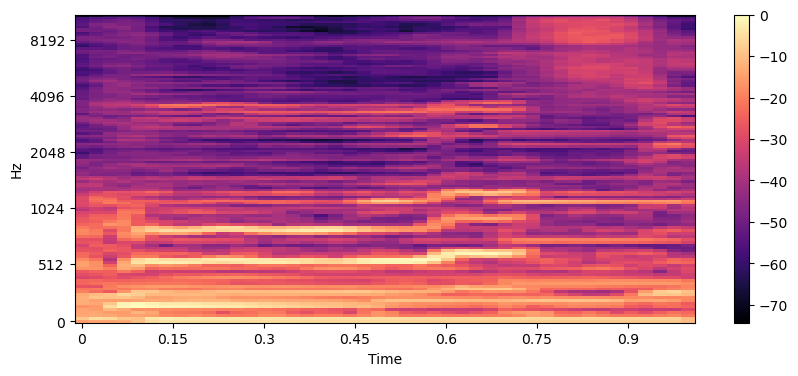

In [15]:
def display_mel_spectrogram(audio, sr):

  # Compute the spectrogram of the audio
  spectrogram = librosa.feature.melspectrogram(y=audio, sr=sr)
  print(spectrogram.shape)

  # Convert the spectrogram to decibels
  spectrogram_db = librosa.power_to_db(spectrogram, ref=np.max)
  print(spectrogram_db.shape)

  # Plot the spectrogram
  plt.figure(figsize=(10, 4))
  librosa.display.specshow(spectrogram_db, x_axis='time', y_axis='mel', sr=sr)
  plt.colorbar()
  plt.show()
  return spectrogram_db

mel_spec = display_mel_spectrogram(audio_segment, sr)

In [16]:
print(mel_spec.shape)
print(mel_spec[0])
print(mel_spec[-1])

(128, 44)
[-15.003289  -13.828626  -14.018078  -13.078522   -9.700481   -5.3388004
  -4.0173893  -4.2043514  -4.5273514  -4.6772995  -4.76       -4.884115
  -5.052992   -5.199253   -5.358282   -5.446762   -5.5882664  -5.7284946
  -5.86154    -6.00955    -6.092619   -6.2665157  -6.3778706  -6.4096603
  -6.573511   -6.699934   -6.818983   -6.825367   -6.930086   -7.094185
  -7.2285366  -7.210495   -7.280628   -7.3637333  -7.5507145  -7.7382717
  -7.6767635  -7.8550816  -8.008162   -8.182817   -8.186413   -8.305922
  -8.371641  -10.338278 ]
[-71.39996  -68.077354 -65.26217  -63.94541  -63.223953 -68.2072
 -73.95237  -73.25071  -73.722374 -74.32065  -72.90993  -64.38955
 -59.257454 -58.879128 -59.48114  -59.268192 -61.05361  -67.38399
 -69.93271  -66.20782  -63.84961  -62.010002 -58.50065  -53.04162
 -52.261047 -52.485565 -56.603905 -61.4495   -63.133972 -62.46142
 -60.370075 -51.350067 -48.266838 -47.37105  -45.3052   -45.21077
 -43.563652 -42.517548 -43.791115 -49.026146 -53.576874 -60.7

## function 2 to display spectogram


In [17]:
# from https://towardsdatascience.com/extract-features-of-music-75a3f9bc265d
def display_spec2(audio, sr, print_log=False):
  #display Spectrogram
  X = librosa.stft(audio)
  Xdb = librosa.amplitude_to_db(abs(X))
  plt.figure(figsize=(14, 5))
  #If to pring log of frequencies
  if print_log:
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
  else:
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
  plt.colorbar()

## display spectrogram of a song (3 ways)

(128, 44)
(128, 44)


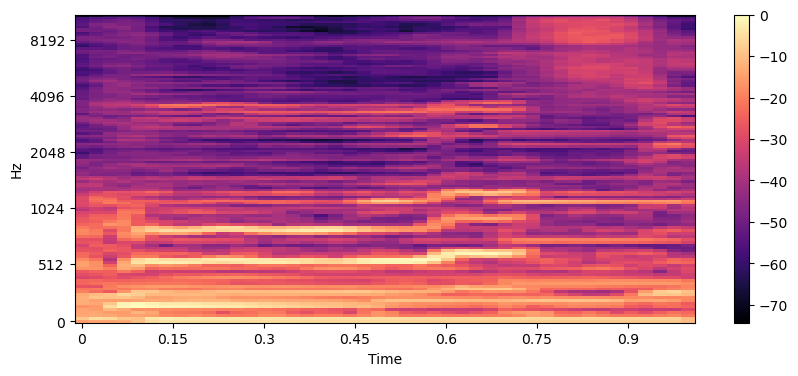

array([[-15.003289 , -13.828626 , -14.018078 , ...,  -8.305922 ,
         -8.371641 , -10.338278 ],
       [ -8.516817 ,  -5.054928 ,  -5.5235157, ...,  -6.7851276,
         -7.140566 , -10.6565895],
       [-13.403168 , -13.260769 , -13.934617 , ..., -20.07144  ,
        -19.095652 , -21.076988 ],
       ...,
       [-55.91429  , -53.122963 , -50.90219  , ..., -48.70323  ,
        -51.751106 , -53.261574 ],
       [-56.800232 , -54.499966 , -53.963608 , ..., -52.031975 ,
        -55.72377  , -56.01829  ],
       [-71.39996  , -68.077354 , -65.26217  , ..., -60.71617  ,
        -68.57211  , -69.84657  ]], dtype=float32)

In [19]:

display_mel_spectrogram(audio_segment, sr)

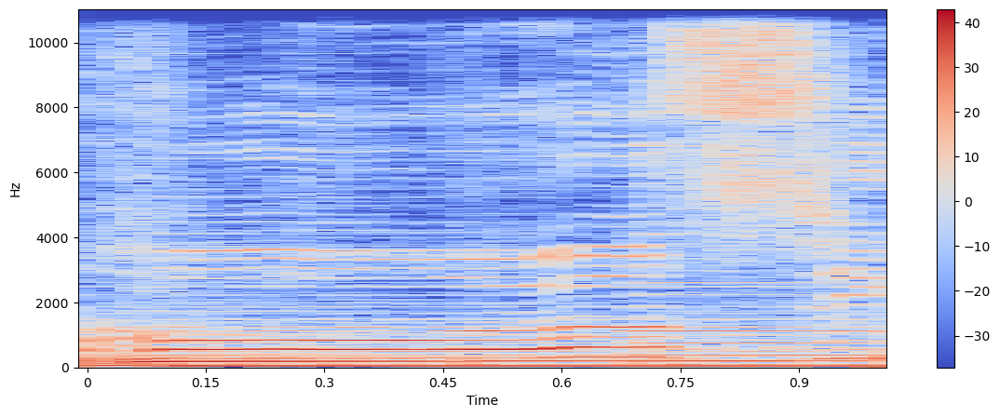

In [20]:
display_spec2(audio_segment, sr)

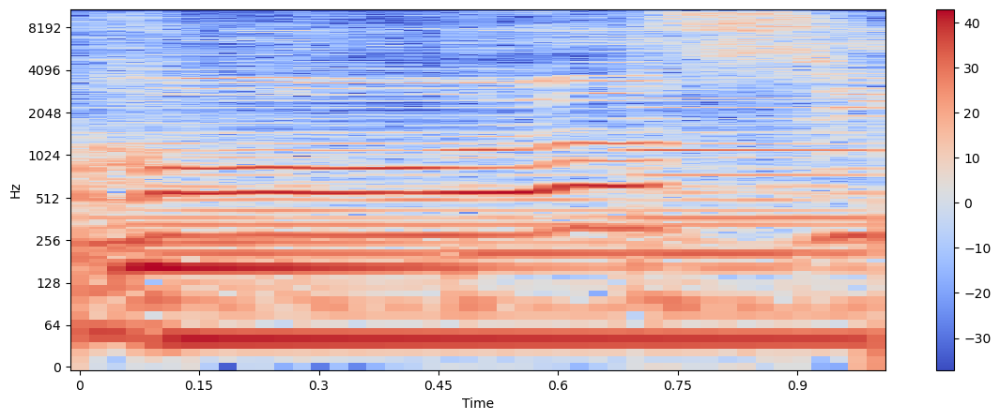

In [21]:
display_spec2(audio_segment, sr, print_log=True)

### which is the best way?
Probably `display_spec2`.

## mfcc

(20, 44)


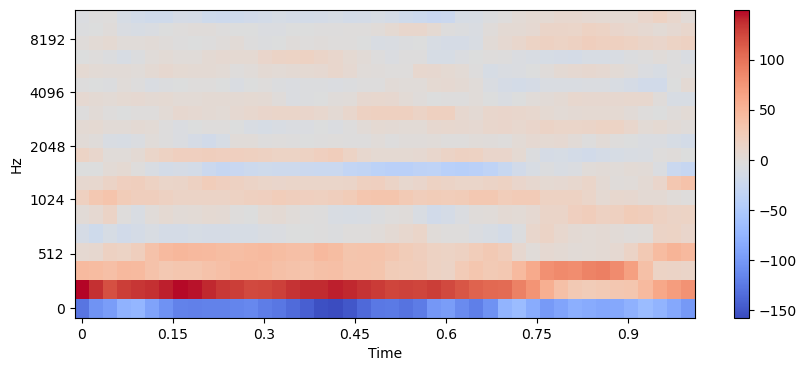

In [22]:
# prompt: calc the mfcc

def print_mfcc(audio_segment, sr):
  import matplotlib.pyplot as plt
  mfccs = librosa.feature.mfcc(y=audio_segment, sr=sr)
  print(mfccs.shape)
  plt.figure(figsize=(10, 4))
  librosa.display.specshow(mfccs, x_axis='time', y_axis='mel', sr=sr)
  plt.colorbar()
  plt.show()
  return mfccs

mfccs = print_mfcc(audio_segment, sr)


In [23]:
mfccs[0]

array([-128.12646 , -105.65778 ,  -97.424255,  -77.35898 ,  -74.03834 ,
        -92.52333 , -106.56825 , -118.32642 , -120.24428 , -118.38422 ,
       -118.69723 , -116.6612  , -114.18172 , -121.97887 , -126.36761 ,
       -134.88605 , -144.30934 , -155.0078  , -157.57127 , -149.99648 ,
       -136.69067 , -125.3542  , -124.7959  , -129.81595 , -123.30232 ,
       -101.884995,  -96.70683 , -111.34608 , -120.98146 , -106.27095 ,
        -76.05748 ,  -68.45795 ,  -83.43321 ,  -99.09881 ,  -91.21457 ,
        -80.96135 ,  -84.480865,  -88.329475,  -87.12662 ,  -79.29371 ,
        -68.06039 ,  -76.68765 ,  -87.25166 , -100.90344 ], dtype=float32)

## Attempt at some Classification

extracting segment:  sampling rate 22050 start_time 50 end_time 51
(20, 44)


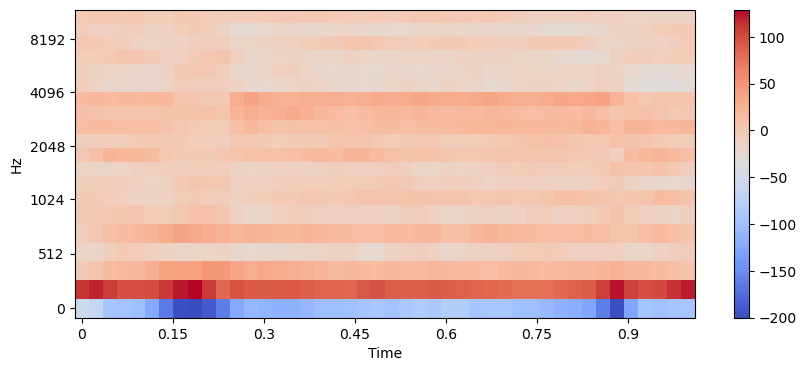

In [24]:
audio, sr = librosa.load('beloved-2024.mp3')
audio_segment = extract_segment(audio, sr, 50, 51)
mfccs = print_mfcc(audio_segment, sr)


(4755392,) [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
extracting segment:  sampling rate 22050 start_time 50 end_time 51
(20, 44)


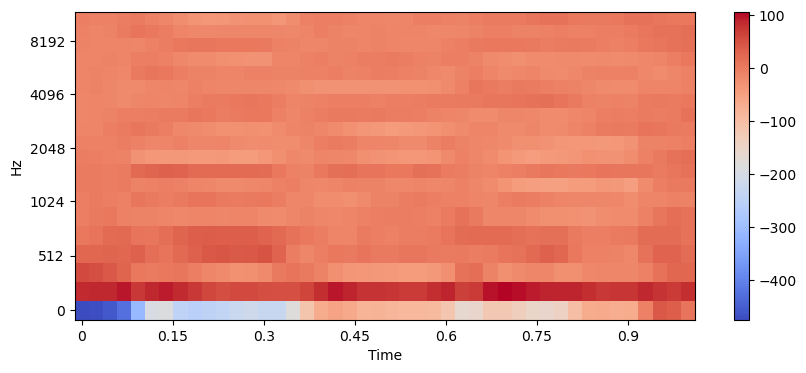

In [25]:
audio, sr = librosa.load('beloved-reimagined-2024.mp3')
print(audio.shape, audio[1000:1010])
audio_segment = extract_segment(audio, sr, 50, 51)
mfccs = print_mfcc(audio_segment, sr)


In [26]:
# prompt: sum the absolute value of the raw audio and find average

import numpy as np
audio, sr = librosa.load('beloved-2024.mp3')
raw_audio_sum = np.sum(np.abs(audio))
print(raw_audio_sum / len(audio))


0.12909862586248058


In [ ]:
# prompt: sum the absolute value of the raw audio and find average

import numpy as np
audio, sr = librosa.load('beloved-reimagined-2024.mp3')
raw_audio_sum = np.sum(np.abs(audio))
print(raw_audio_sum / len(audio))


0.16039315213130695


In [ ]:
# prompt: sum the absolute value of the raw audio and find average

import numpy as np
audio, sr = librosa.load('diamond-2024.mp3')
raw_audio_sum = np.sum(np.abs(audio))
print(raw_audio_sum / len(audio))


0.17127303085739387


In [ ]:
# prompt: sum the absolute value of the raw audio and find average

import numpy as np
audio, sr = librosa.load('disciple-of-christ-2024.mp3')
raw_audio_sum = np.sum(np.abs(audio))
print(raw_audio_sum / len(audio))


0.1518691925778885


In [ ]:
audio, sr = librosa.load('truth-2024.mp3')
print(np.sum(np.abs(audio)) / len(audio))

0.1656074815213022


In [ ]:
audio, sr = librosa.load('he-still-chose-me-2024.mp3')
print(np.sum(np.abs(audio)) / len(audio))

0.13106442572605717


In [ ]:
audio, sr = librosa.load('one-true-hope-2024.mp3')
print(np.sum(np.abs(audio)) / len(audio))

0.14876759171785464


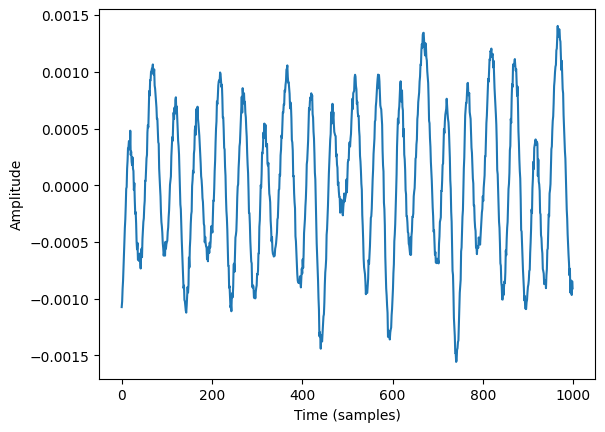

In [ ]:
# prompt: print a graph of a segment of the audio

import matplotlib.pyplot as plt
# Load the audio file
audio_file = 'beloved-2024.mp3'

# Load the audio as a time series and its sample rate
audio, sr = librosa.load(audio_file)

# Extract a segment of the audio
audio_segment = audio[10000:11000]

# Plot the audio segment
plt.plot(audio_segment)
plt.xlabel('Time (samples)')
plt.ylabel('Amplitude')
plt.show()


## zero-crossing rate

In [ ]:
# prompt: calculate num of zero crossings

def zero_crossing_rate(audio):
  """
  Calculates the zero-crossing rate of an audio signal.

  Args:
    audio: A NumPy array containing the audio signal.

  Returns:
    The zero-crossing rate of the audio signal.
  """

  # Count the number of zero crossings
  zero_crossings = 0
  for i in range(1, len(audio)):
    if audio[i] * audio[i - 1] < 0:
      zero_crossings += 1

  # Calculate the zero-crossing rate
  zero_crossing_rate = zero_crossings / len(audio)

  return zero_crossing_rate

audio_beloved, sr = librosa.load('beloved-2024.mp3')
audio_beloved_reimagined, sr = librosa.load('beloved-reimagined-2024.mp3')
print(zero_crossing_rate(audio_beloved), zero_crossing_rate(audio_beloved_reimagined))

0.09548802889990084 0.08575591665208672


In [ ]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(audio_segment, sr=sr)

AttributeError: module 'librosa.display' has no attribute 'waveplot'

<Figure size 1400x500 with 0 Axes>

In [ ]:
n0 = 9000
n1 = 9100
zero_crossings = librosa.zero_crossings(audio_segment[n0:n1], pad=False)
print(sum(zero_crossings))

zero_crossings = librosa.zero_crossings(audio_segment, pad=False)
print(sum(zero_crossings))

print(len(audio_segment))

4
13875
220500


In [ ]:
# prompt: compute the mfcc of an audio

import matplotlib.pyplot as plt
import numpy as np
mfcc = librosa.feature.mfcc(y=audio_segment, sr=sr)
print(mfcc.shape)
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfcc, x_axis='time', y_axis='mel', sr=sr, x_ticks=np.arange(0, 10, 2), y_ticks=np.arange(0, 13, 3))
plt.colorbar()
plt.show()


NameError: name 'librosa' is not defined

In [32]:
import pandas as pd

labels = pd.read_csv('my-class.csv')
labels

,Year,Slug,Song,Tempo,Synth,Like
0,2013,stand-2013,Stand,1.0,False,2
1,2013,its-a-good-start-2013,It’s a Good Start,3.0,True,2
2,2013,joy-of-life-2013,Joy of Life,2.0,False,2
3,2013,look-up-2013,Look Up,3.0,True,2
4,2013,who-will-2013,Who Will,3.0,True,2
5,2013,little-things-2013,Little Things,3.0,False,2
6,2013,mountains-to-climb-2013,Mountains to Climb,2.0,False,2
7,2013,still-and-quiet-moments-2013,Still and Quiet Moments,1.0,False,2
8,2013,im-changed-2013,I’m Changed,1.0,False,2
9,2013,if-we-forget-ourselves-2013,If we forget ourselves,3.0,False,2
